In [1]:
import yaml
import sys
sys.path.append("..")

import os.path as osp

import torch
import numpy as np
import matplotlib.pyplot as plt

from tqdm.notebook import tqdm_notebook as tqdm
import torch.nn as nn
from torch_model import DiT
from torch_vae import AutoencoderKL

In [2]:
import numpy as np

def show_image_grid(images, cols, figsize=(12,12), save_path=None, cmap=None):
    """
    Draw a grid of images.

    Args:
        images: numpy array or list-like of shape (B, H, W, C) or (B, C, H, W).
                Expected H=W=256 and C=3, but other sizes will work too.
                Values can be uint8 [0..255], float [0..1] or float in [-1,1].
        rows: number of grid rows.
        cols: number of grid columns.
        figsize: tuple passed to plt.figure.
        save_path: optional path to save the figure (PNG/JPG). If None, figure is not saved.
        cmap: optional colormap for single-channel images.

    Returns:
        fig, axes - matplotlib Figure and axes array (flattened).
    """
    # Convert input to numpy array
    imgs = np.asarray(images)

    if imgs.ndim not in (3,4):
        raise ValueError(f"images must be 3D or 4D array, got shape {imgs.shape}")

    # If single image (H,W,C), expand to batch
    if imgs.ndim == 3:
        imgs = imgs[None, ...]

    B = imgs.shape[0]

    if B<cols:
        cols=B
        rows=1
    else:
        rows = B//cols + int(B%cols!=0)
    
    # Normalize to float in [0,1] for plotting
    if imgs.dtype == np.uint8:
        imgs_plot = imgs.astype(np.float32) / 255.0
    else:
        imgs_plot = imgs.astype(np.float32)
        # If values appear in [-1,1], convert to [0,1]
        if imgs_plot.min() < -0.1 and imgs_plot.max() <= 1.1:
            imgs_plot = (imgs_plot * 0.5) + 0.5
        # clip any out-of-range values
        imgs_plot = np.clip(imgs_plot, 0.0, 1.0)

    # Prepare grid: only display up to rows*cols images
    grid_n = rows * cols
    display_n = min(B, grid_n)

    # If fewer images than grid, create black placeholders
    H, W = imgs_plot.shape[1], imgs_plot.shape[2]
    if imgs_plot.shape[3] == 1:
        imgs_plot = imgs_plot[...,0]  # will be handled by imshow single channel

    padded = []
    for i in range(grid_n):
        if i < display_n:
            padded.append(imgs_plot[i])
        else:
            # black image
            if imgs_plot.ndim == 4 and imgs_plot.shape[3] == 3:
                padded.append(np.zeros((H, W, 3), dtype=np.float32))
            else:
                padded.append(np.zeros((H, W), dtype=np.float32))
    padded = np.stack(padded, axis=0)

    # Create figure and axes
    fig, axes = plt.subplots(rows, cols, figsize=figsize)
    # axes may be 2D array; flatten for easy indexing
    axes_flat = np.array(axes).reshape(-1)

    for idx, ax in enumerate(axes_flat):
        img = padded[idx]
        ax.axis('off')
        if img.ndim == 3 and img.shape[2] == 3:
            ax.imshow(img, interpolation='nearest')
        else:
            ax.imshow(img, cmap=cmap or 'gray', interpolation='nearest', vmin=0.0, vmax=1.0)

    plt.tight_layout(pad=0.0)
    if save_path:
        plt.savefig(save_path, bbox_inches='tight', pad_inches=0)
    return fig, axes_flat

## For FID

In [3]:
from skimage.transform import resize
from utils.fid import get_fid_network, fid_from_stats
get_fid_activations = get_fid_network()
fid_stats = "../results/celebahq256_fid_stats.npz"
truth_fid_stats = np.load(fid_stats)



def calc_fid(all_images):
    resized_images = np.stack([resize(img, (299, 299, 3), anti_aliasing=True) for img in all_images])
    resized_images = np.clip(resized_images, -1, 1)
    acts = get_fid_activations(resized_images)
    if acts.ndim == 4 and acts.shape[1:3] == (1, 1):
        acts = acts[..., 0, 0, :] if acts.shape[-1] == 2048 else acts.squeeze((1,2))
    acts = np.array(acts)
    mu1 = np.mean(acts, axis=0)
    sigma1 = np.cov(acts, rowvar=False)
    
    fid = fid_from_stats(mu1, sigma1, truth_fid_stats['mu'], truth_fid_stats['sigma'])
    return fid


In [4]:
yaml_path = "../shortcutmodel_args.yaml"
device = "cuda"

In [5]:
with open(yaml_path, 'r') as f:
    config = yaml.safe_load(f)
    
dit_args = config['dit_args']
dit_args["dtype"] = torch.float32
vae_args = config['vae_args']
dit_weights = config.get('dit_weights', None).replace("shortcut-models", "..")
vae_weights = config.get('vae_weights', None).replace("shortcut-models", "..")




In [6]:
dit = DiT(**dit_args).to(device)
if dit_weights is not None:
    dit.load_state_dict(torch.load(dit_weights, map_location=device))
dit.eval()
vae = AutoencoderKL(**vae_args).to(device)
if vae_weights is not None:
    vae.load_state_dict(torch.load(vae_weights, map_location=device))

In [65]:
from typing import Iterable, List, Tuple
import math

def build_step_schedule(fractions: Iterable[float],
                        step_sizes: Iterable[int],
                        *,
                        tol: float = 1e-8) -> Tuple[List[int], List[int]]:
    """
    Build two parallel lists (indices, totals) so that calling step(idx, tot)
    for each zipped pair traverses the path described by `fractions` using the
    provided `step_sizes` for each segment.

    Args:
        fractions: sequence of positive floats that sum to 1.0
        step_sizes: sequence of positive integers (e.g., 1,2,4,8,16,32,64,128).
                    Same length as fractions. Each fraction * step_size must be an integer.
        tol: tolerance for floating comparisons.

    Returns:
        (indices, totals) where len(indices) == len(totals). For each k,
        call step(indices[k], totals[k]).

    Example:
        fractions = (0.5, 0.25, 0.25)
        step_sizes = (2, 64, 128)

        -> indices = [0, 32, 33, ..., 47, 96, ..., 127]
           totals  = [2, 64, 64, ..., 64, 128, ..., 128]
    """
    fracs = list(fractions)
    sizes = list(step_sizes)
    if len(fracs) == 0:
        raise ValueError("fractions must be non-empty.")
    if len(fracs) != len(sizes):
        raise ValueError("fractions and step_sizes must have the same length.")

    # basic validity
    if any(f <= 0 for f in fracs):
        raise ValueError("All fractions must be positive.")
    if any(s <= 0 or not isinstance(s, int) for s in sizes):
        raise ValueError("All step_sizes must be positive integers.")

    ssum = sum(fracs)
    if not (abs(ssum - 1.0) <= tol):
        raise ValueError(f"fractions must sum to 1.0 (sum={ssum})")

    indices: List[int] = []
    totals: List[int] = []

    cumulative_frac = 0.0
    for f, S in zip(fracs, sizes):
        # number of steps in this segment for the given granularity S
        exact_n = f * S
        n = int(round(exact_n))
        if not (abs(exact_n - n) <= tol):
            raise ValueError(f"fraction {f} * step_size {S} must be integer (got {exact_n})")
        if n == 0:
            # allow zero-length segment only if f == 0 (we checked f>0 above), so error
            raise ValueError(f"Segment with fraction {f} and step_size {S} results in zero steps.")
        # start index in [0, S-1] (inclusive)
        start = int(round(cumulative_frac * S))
        end = start + n  # exclusive
        if end > S:
            # numerical safety: trim to S
            end = S
        # add indices start .. end-1 with total S
        for idx in range(start, end):
            indices.append(idx)
            totals.append(S)

        # advance cumulative fraction
        cumulative_frac += f

    # final checks: for the last segment, ensure last index equals S-1 of its S
    # (this should hold by construction if fractions sum to 1 and integer counts matched)
    if len(indices) == 0:
        return indices, totals

    # Remove possible duplicates and ensure monotonic within each (index,total) pair sequence:
    # (we preserve order; duplicates unlikely but handle gracefully)
    cleaned_idx = []
    cleaned_tot = []
    seen = set()
    for idx, tot in zip(indices, totals):
        key = (idx, tot)
        if key in seen:
            continue
        seen.add(key)
        cleaned_idx.append(idx)
        cleaned_tot.append(tot)

    return cleaned_idx, cleaned_tot

In [68]:
num_generations = 16
image_size = 32
in_channels = 4
num_classes = 1
cfg_scale = 0
model = dit

def step(x, ti, denoise_timesteps, labels):
    batch_size = x.shape[0]
    delta_t = 1.0 / denoise_timesteps
    t = ti / denoise_timesteps
    t_vector = torch.full((batch_size,), t, dtype=torch.float32, device=device)
    dt_flow = int(np.log2(denoise_timesteps))
    dt_base = torch.ones(batch_size, dtype=torch.float32, device=device) * dt_flow

    # Classifier-free guidance
    labels_uncond = torch.ones_like(labels) * num_classes
    if cfg_scale == 1:
        v, *_ = model(x, t_vector, dt_base, labels)
    elif cfg_scale == 0:
        v, *_ = model(x, t_vector, dt_base, labels_uncond)
    else:
        v_pred_uncond, *_ = model(x, t_vector, dt_base, labels_uncond)
        v_pred_label, *_ = model(x, t_vector, dt_base, labels)
        v = v_pred_uncond + cfg_scale * (v_pred_label - v_pred_uncond)

    # Euler sampling
    x = x + v * delta_t
    return x
    
def generate(batch_size, num_generations, fractions, step_sizes, show_progress=True, tol=1e-8):
    all_images = []
    with torch.no_grad():
        for gen_idx in tqdm(range(num_generations // batch_size)):
            # Sample initial noise in latent space
            x = np.random.randn(batch_size, image_size, image_size, in_channels).astype(np.float32)
            x = torch.Tensor(x).to(device)
            labels = torch.randint(0, num_classes, (batch_size,), device=device)
            schedule = list(zip(*build_step_schedule(fractions, step_sizes, tol=tol)))
            if show_progress:
                schedule = tqdm(schedule)
            for ti, dts in schedule:
                x = step(x, ti, dts, labels)
    
            # VAE decode (Torch)
            # x: (B, H, W, C) -> (B, C, H, W)
            x_np = x.detach().cpu().numpy()
            x_torch = torch.Tensor(x_np).permute(0, 3, 1, 2).to(device)
            x_decoded = vae.decode(x_torch)
            x_decoded = np.array(x_decoded.detach().cpu().numpy().transpose(0, 2, 3, 1))  # (B, H, W, C)
            x_decoded_vis = x_decoded * 0.5 + 0.5  # [-1,1] to [0,1]
            x_decoded_vis = np.clip(x_decoded_vis, 0, 1)
            x_img = (x_decoded_vis * 255).astype(np.uint8)
            all_images.append(x_img)
    
        all_images = np.concatenate(all_images, axis=0)
    return all_images

## Original Setup - 128 steps

In [10]:
fractions=(1, )
step_sizes=(128, )
all_images = generate(16, 512, fractions, step_sizes, show_progress=False)

  0%|          | 0/32 [00:00<?, ?it/s]

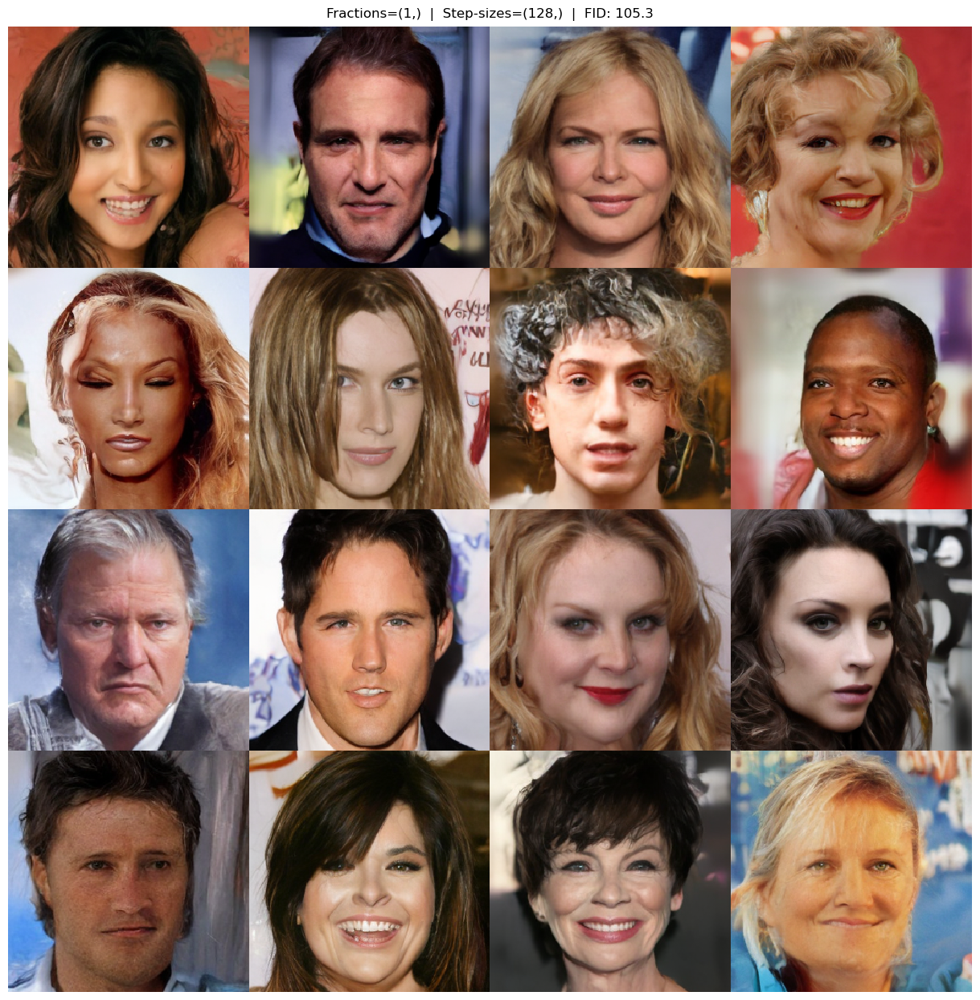

In [11]:
fig, ax = show_image_grid(all_images[:16], 4)
_=fig.suptitle(f"Fractions={fractions}  |  Step-sizes={step_sizes}  |  FID: {calc_fid(all_images):.1f}", y=1.02)

## 2 steps

In [16]:
fractions=(1, )
step_sizes=(2, )
all_images = generate(16, 512, fractions, step_sizes, show_progress=False)

  0%|          | 0/32 [00:00<?, ?it/s]

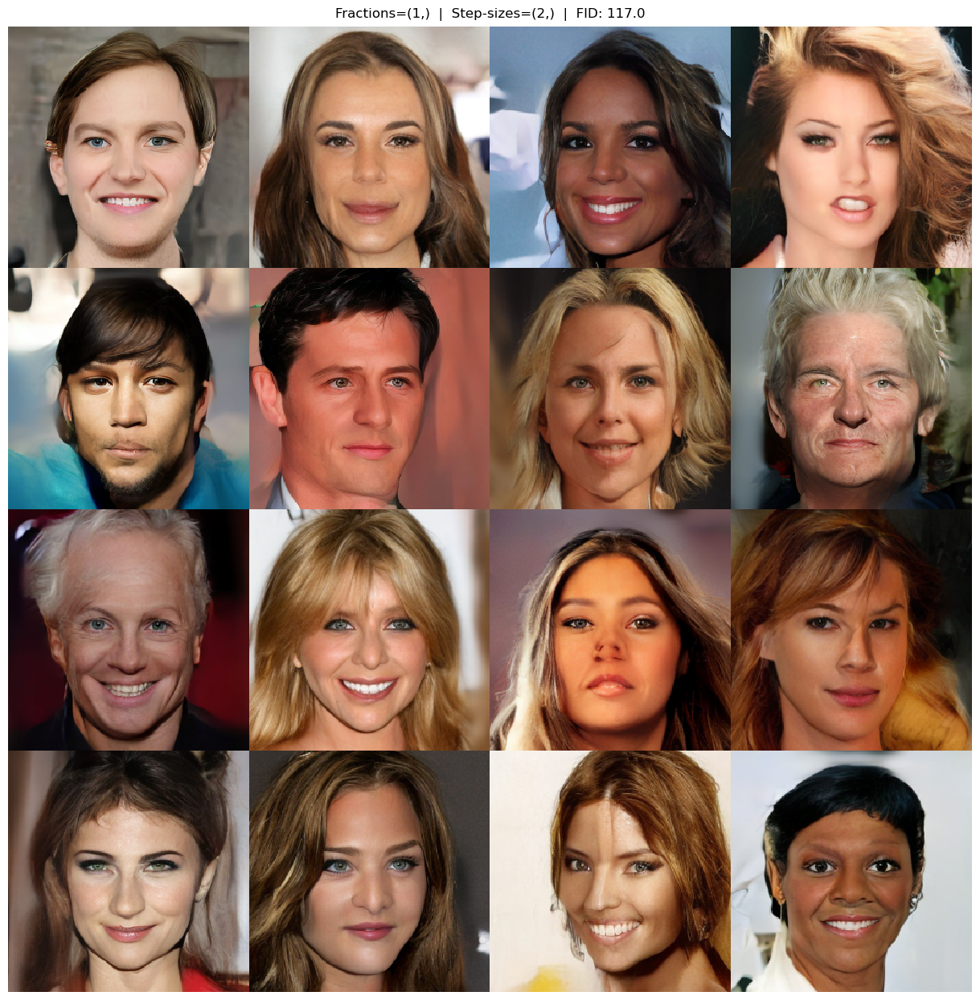

In [17]:
fig, ax = show_image_grid(all_images[:16], 4)
_=fig.suptitle(f"Fractions={fractions}  |  Step-sizes={step_sizes}  |  FID: {calc_fid(all_images):.1f}", y=1.02)

## 1 step half the way then 64 steps of size 128

In [12]:
fractions=(0.5, 0.5)
step_sizes=(2, 128)
all_images = generate(16, 512, fractions, step_sizes, show_progress=False)

  0%|          | 0/32 [00:00<?, ?it/s]

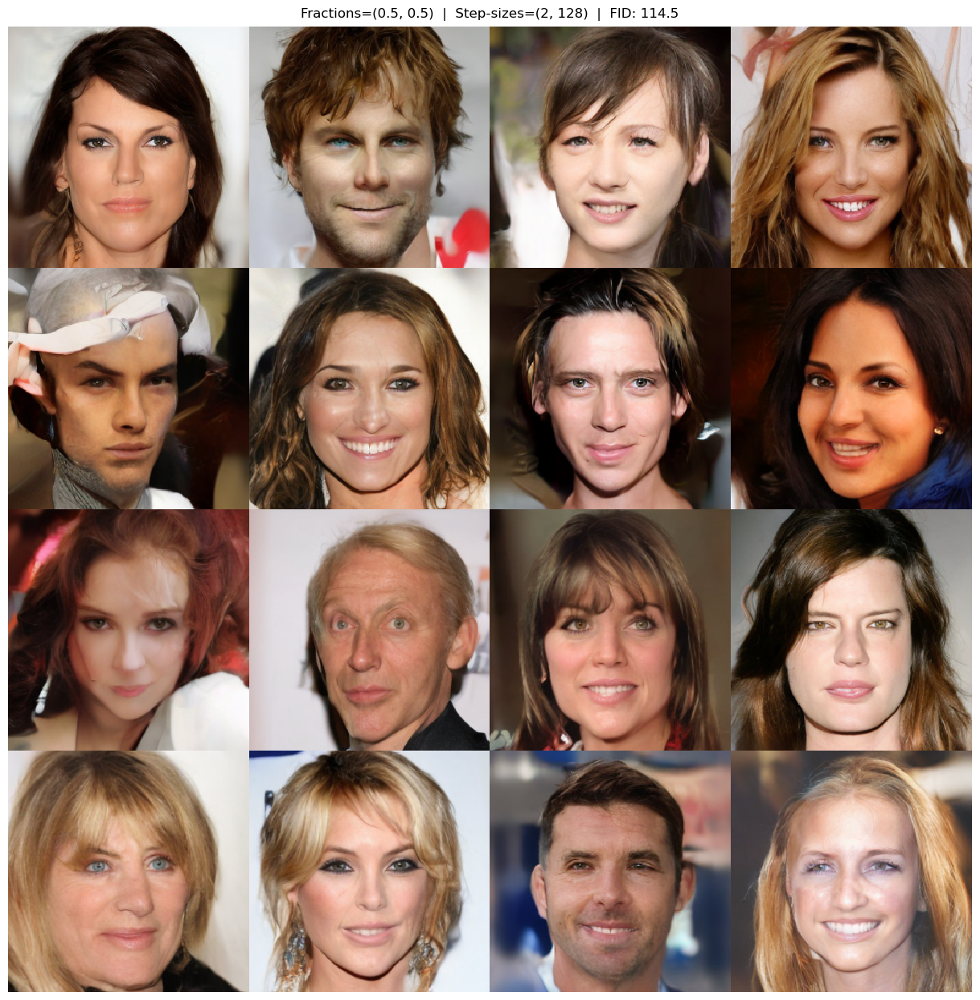

In [13]:
fig, ax = show_image_grid(all_images[:16], 4)
_=fig.suptitle(f"Fractions={fractions}  |  Step-sizes={step_sizes}  |  FID: {calc_fid(all_images):.1f}", y=1.02)

## 1 step half the way, 16 steps of size 1/64 for the next 1/4 of the path and the last quarter with step size 1/128

In [14]:
fractions=(0.5, 0.25, 0.25)
step_sizes=(2, 64, 128)
all_images = generate(16, 512, fractions, step_sizes, show_progress=False)

  0%|          | 0/32 [00:00<?, ?it/s]

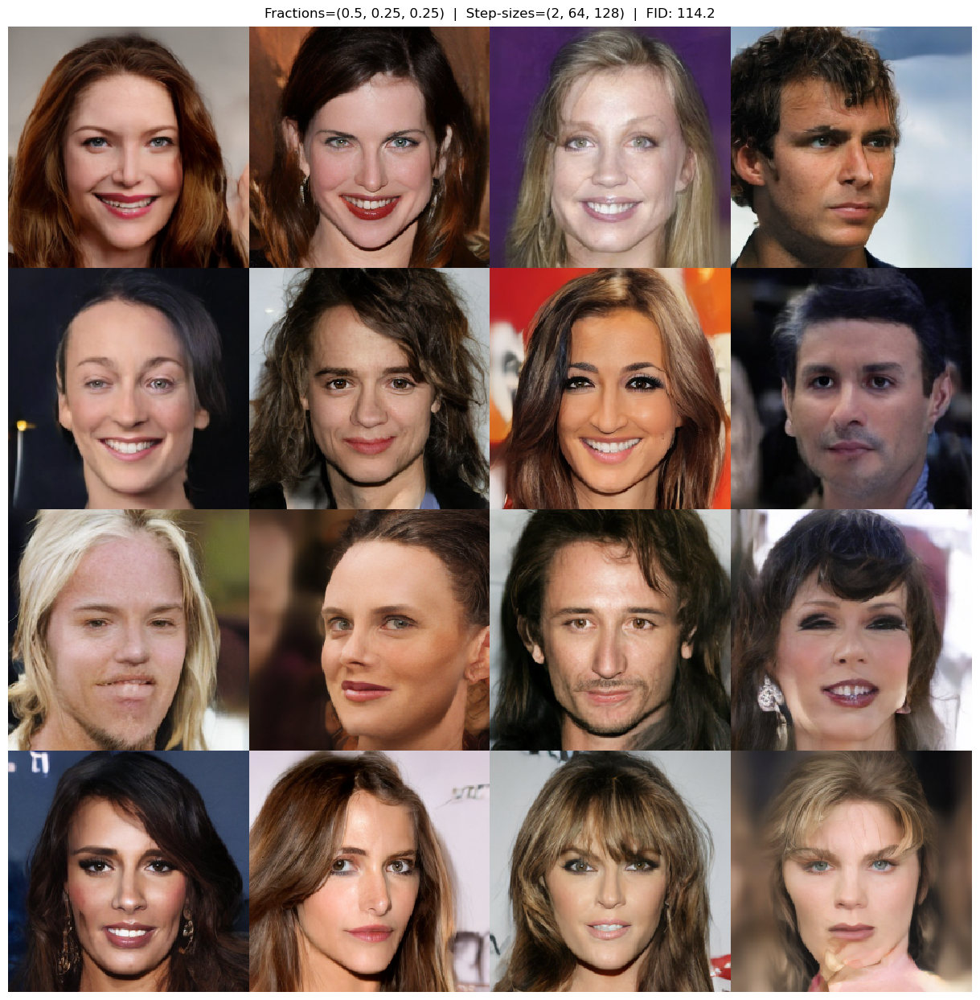

In [15]:
fig, ax = show_image_grid(all_images[:16], 4)
_=fig.suptitle(f"Fractions={fractions}  |  Step-sizes={step_sizes}  |  FID: {calc_fid(all_images):.1f}", y=1.02)

## 3 steps of size 1/4, 1/8 of the way with size 1/32 and the rest with steps of 1/128

In [19]:
fractions=(0.75, 0.125, 0.125)
step_sizes=(4, 32, 128)
all_images = generate(16, 512, fractions, step_sizes, show_progress=False)

  0%|          | 0/32 [00:00<?, ?it/s]

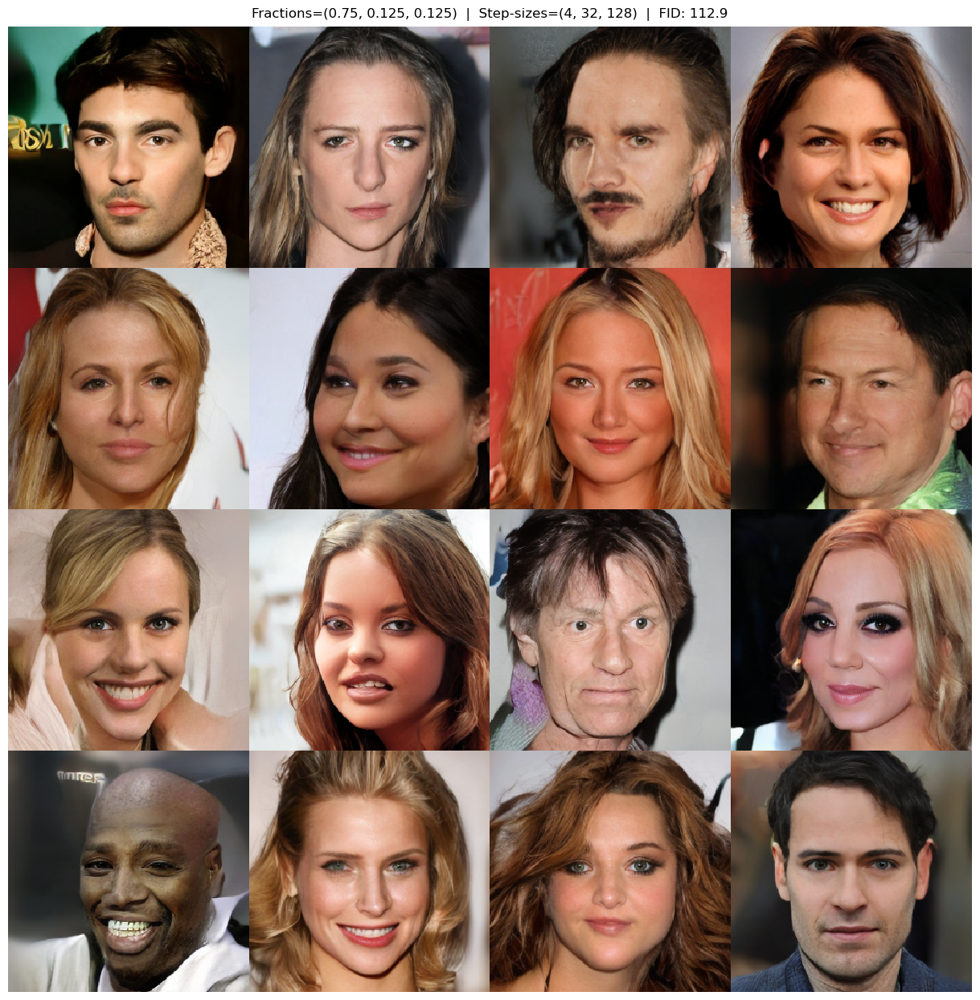

In [20]:
fig, ax = show_image_grid(all_images[:16], 4)
_=fig.suptitle(f"Fractions={fractions}  |  Step-sizes={step_sizes}  |  FID: {calc_fid(all_images):.1f}", y=1.02)

# Irregular sampling

In [84]:
fractions=(35/128, 93/128)
# fractions=(27/128, 101/128)
step_sizes=(128, 2)
all_images = generate(16, 512, fractions, step_sizes, show_progress=False, tol=1)

  0%|          | 0/32 [00:00<?, ?it/s]

In [ ]:
build_step_schedule(fractions, step_sizes, tol=1)

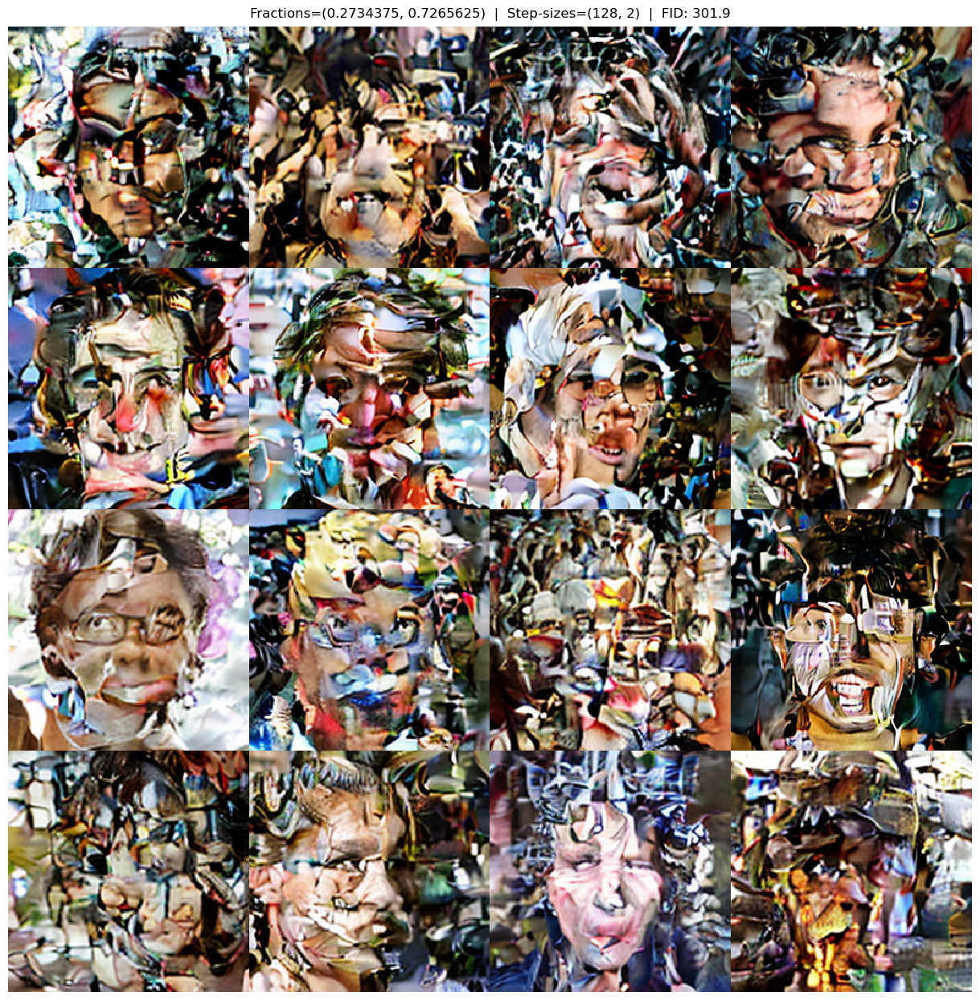

In [86]:
fig, ax = show_image_grid(all_images[:16], 4)
_=fig.suptitle(f"Fractions={fractions}  |  Step-sizes={step_sizes}  |  FID: {calc_fid(all_images):.1f}", y=1.02)

In [27]:
from matplotlib import patches
def draw_hierarchical_arches(n_ticks: int = 128,
                             ax: plt.Axes = None,
                             base_height: float = 0.35,
                             height_growth: float = 1.25,
                             arc_kwargs: dict = None) -> plt.Axes:
    """
    Draw hierarchical arches over an axis with n_ticks ticks (0..n_ticks-1).

    This function DOES NOT draw tick markers explicitly. It relies on the
    axis's natural ticks/labels. It draws dyadic arches: for levels s=1,2,4,...
    up to n_ticks//2 it draws arches that span blocks of size 2*s.

    Args:
        n_ticks: number of discrete tick positions along the x axis.
        ax: optional matplotlib Axes. If None, a new figure+axes is created.
        base_height: base multiplier for arc height relative to block width.
        height_growth: multiplier for growth of arc heights between levels.
        arc_kwargs: kwargs passed to the patch drawing (edgecolor, linewidth, alpha).

    Returns:
        The matplotlib Axes with the arches added.
    """
    if ax is None:
        fig, ax = plt.subplots(figsize=(28, 5))

    if arc_kwargs is None:
        arc_kwargs = {"edgecolor": "C0", "linewidth": 1.0, "alpha": 0.85}

    # Set horizontal limits so arches are nicely positioned; do not modify xticks
    ax.set_xlim(-0.5, n_ticks - 0.5)
    # Hide y-axis visuals
    ax.get_yaxis().set_visible(False)

    # Build dyadic levels: s = 1,2,4,... up to n_ticks//2
    levels = []
    s = 1
    while s <= (n_ticks // 2):
        levels.append(s)
        s *= 2
    levels.append(n_ticks)
    # Draw arches per level. Higher levels drawn later (on top) with larger heights.
    for level_idx, s in enumerate(levels):
        arc_kwargs["edgecolor"] = f"C{level_idx}"
        block_size = 1 * s
        height_factor = base_height * (height_growth ** level_idx)
        for start in range(0, n_ticks, block_size):
            end = start + block_size 
            if end >= n_ticks:
                end = n_ticks - 1
            center = 0.5 * (start + end)
            width = (end - start)
            if width <= 0:
                continue
            arc_width = width
            arc_height = width * height_factor
            arc = patches.Arc((center, 0.0),
                              width=arc_width * 1.0,
                              height=arc_height * 1.0,
                              angle=0.0,
                              theta1=0.0,
                              theta2=180.0,
                              **arc_kwargs)
            ax.add_patch(arc)

    # Tidy up appearance but keep the axis' xticks intact
#     ax.spines['top'].set_visible(False)
#     ax.spines['right'].set_visible(False)
#     ax.spines['left'].set_visible(False)
#     ax.set_ylim(-0.6, None)
    plt.tight_layout(pad=0.5)
    return ax

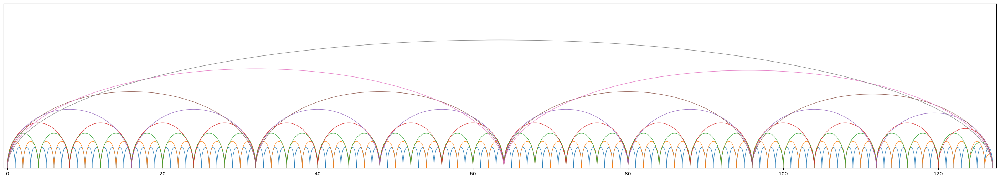

In [32]:
ax = draw_hierarchical_arches(n_ticks=128, base_height=0.25, height_growth=0.65,
                              arc_kwargs={"edgecolor":"C1","linewidth":0.9,"alpha":0.9})

In [94]:
from typing import List, Tuple, Iterable, Optional
from collections import deque
from fractions import Fraction

def shortest_aligned_plan_to_end(current_index: int,
                                 current_total: int,
                                 allowed_totals: Optional[Iterable[int]] = None
                                ) -> Tuple[List[int], List[int]]:
    """
    Compute minimal sequence of aligned steps to reach p == 1 starting from
    p = current_index / current_total under the rule:
      - step(k, T) is allowed only when p == k / T (i.e. p * T is integer)
      - calling step(k, T) moves p -> (k + 1) / T

    Args:
      current_index: int, 0 <= current_index < current_total
      current_total: int, dyadic total (power of two) that current_index refers to
      allowed_totals: iterable of allowed totals (default: [2,4,8,16,32,64,128])

    Returns:
      (indices, totals): two parallel lists describing the calls in order.
    """
    if allowed_totals is None:
        allowed_totals = [2, 4, 8, 16, 32, 64, 128]
    allowed = sorted(set(allowed_totals))

    if current_total not in allowed:
        raise ValueError("current_total must be one of allowed_totals")

    if current_total < 2 or (current_total & (current_total - 1)) != 0:
        raise ValueError("current_total must be a power of two >= 2")
    if not (0 <= current_index < current_total):
        raise ValueError("current_index must be in [0, current_total-1]")

    start_p = Fraction(current_index, current_total)
    target = Fraction(1, 1)

    # Quick exit if somehow already at or beyond end
    if start_p >= target:
        return [], []

    # BFS over reachable p values (rationals of form (k+1)/T)
    q = deque([start_p])
    prev = {start_p: (None, None)}  # map p -> (prev_p, (idx, T))
    visited = {start_p}

    while q:
        p = q.popleft()
        # for each allowed grid T, only allow a step if p * T is integer
        for T in allowed:
            # check alignment: p * T must be integer
            if (p.numerator * T) % p.denominator != 0:
                continue
            k = (p.numerator * T) // p.denominator  # exact integer
            # k must be in [0, T-1] since p < 1
            if not (0 <= k < T):
                continue
            p_next = Fraction(k + 1, T)  # result of step(k,T)
            # only forward progress (should always be > p though)
            if p_next <= p:
                continue
            if p_next in visited:
                continue
            prev[p_next] = (p, (k, T))
            if p_next == target:
                # reconstruct path
                inds: List[int] = []
                tots: List[int] = []
                cur = p_next
                while True:
                    pprev, action = prev[cur]
                    if pprev is None:
                        break
                    k_act, T_act = action
                    inds.append(k_act)
                    tots.append(T_act)
                    cur = pprev
                inds.reverse()
                tots.reverse()
                return inds, tots
            visited.add(p_next)
            q.append(p_next)

    # If we cannot reach p == 1 with these allowed totals, raise.
    raise RuntimeError("Unable to reach end with the given allowed_totals")


# Example usage / sanity-check (copy into a script to run)
if __name__ == "__main__":
    print("Example A (45 on 64):", shortest_aligned_plan_to_end(45, 64))
    # expected -> ([37, 19, 5, 3, 1], [128,64,16,8,2])

    print("Example B (55 on 128):", shortest_aligned_plan_to_end(55, 128))
    # expected -> ([1,1,1], [8,4,2])

Example A (45 on 64): ([45, 23, 3], [64, 32, 4])
Example B (55 on 128): ([55, 7, 1], [128, 16, 2])


[177, 178, 179, 69, 70, 71, 144, 145, 146, 18, 19, 20, 75, 76, 77, 66, 67, 68, 12, 13, 14, 174, 175, 176, 165, 166, 167, 84, 85, 86, 45, 46, 47, 102, 103, 104, 153, 154, 155, 30, 31, 32, 186, 187, 188, 90, 91, 92, 183, 184, 185, 6, 7, 8, 180, 181, 182, 159, 160, 161]


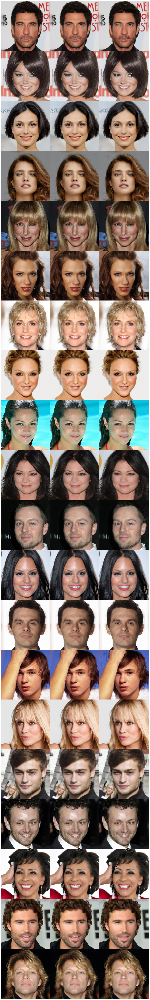

In [12]:
import os.path as osp
from glob import glob
benchmark_dir = "../../resample/results/baseline64/recon"
test_dir = "../results/tests/64_steps_gamma1_mod10/recon"
benchmarl_imgs = glob(osp.join(benchmark_dir, "*.png"))
test_imgs = glob(osp.join(test_dir, "*.png"))
orig_imgs = glob(osp.join(test_dir.replace("recon", "input"), "*.png"))

images = []
for imgp1, imgp2, imgp3 in zip(orig_imgs, benchmarl_imgs, test_imgs):
    images.append(plt.imread(imgp1))
    images.append(plt.imread(imgp2))
    images.append(plt.imread(imgp3))
all_images = np.stack(images)[..., :-1]
n = 20
indices = np.random.permutation(64)[:n]*3
indices_l = []
for i in indices:
    indices_l.append(i)
    indices_l.append(i+1)
    indices_l.append(i+2)
print(indices_l)
fig, ax = show_image_grid(all_images[indices_l], 3, figsize=(4*3, 4*n))

# images = [plt.imread("../results/integration/gamma_1/input/000_true.png"),
#         plt.imread("../results/integration/64_gamma_1/input/001_true.png"),
#     plt.imread("../results/integration/64_gamma_1/recon/000_recon.png"),
# plt.imread("../results/integration/gamma_1/recon/001_recon.png"),
# plt.imread("../../resample/results/benchmarkx2/recon/000_recon.png"),
# plt.imread("../../resample/results/benchmarkx2/recon/001_recon.png")]

# all_images = np.stack(images)[..., :-1]
# fig, ax = show_image_grid(all_images, 2)

In [22]:
from typing import Set

def action_indices_on_coarse_grid(N: int, base: int = 128, interval: int = 10) -> Set[int]:
    """
    Return set of coarse indices j in [0, N-1] that are the nearest mappings
    of original action positions {0, interval, 2*interval, ...} on a timeline of length `base`.
    Rounding rule: j = int(a * N / base + 0.5). Clamped to [0, N-1].
    """
    if N <= 0 or (N & (N - 1)) != 0:
        raise ValueError("N must be a positive power of two (e.g. 1,2,4,8,16,32,64...).")
    indices = set()
    for a in range(0, base, interval):
        j = int((a * N) / base + 0.5)
        if j >= N:
            j = N - 1
        indices.add(j)
    return indices

def is_closest_action(N: int, i: int, base: int = 128, interval: int = 10) -> bool:
    """
    Return True if coarse index i (0 <= i < N) is the nearest coarse position
    to at least one original action (multiples of `interval` on [0..base-1]).
    """
    if not (0 <= i < N):
        raise ValueError("i must be in range(0, N)")
    return i in action_indices_on_coarse_grid(N, base=base, interval=interval)

In [24]:
action_indices_on_coarse_grid(16, 128, 10)

{0, 1, 3, 4, 5, 6, 8, 9, 10, 11, 13, 14, 15}